In [1]:
import glob
import pickle
import datetime
import os.path as path
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from utils import calc_calibration, region_of_interest
from utils import abs_sobel_thresh, mag_thresh, dir_threshold
from utils import warper, draw_lane_field
from utils import window_mask, find_window_centroids_conv, find_window_centroids_window_search, fit_lane_line
from utils import detect_lane_curvature_v1, detect_lane_curvature_v2
# import Line


In [2]:
DEBUG_FLAG = False

## 1. Camera Calibration

In [3]:
%matplotlib inline
# Get paths of calibration test image
cal_image_files = glob.glob('camera_cal/calibration*.jpg')

# Check if we have done the camera calibration, read camera matrix, 
# vector of disortion coefficients and image size from the pickle file
if path.isfile("calibration_mtx_dist_pickle.p"):
    with open("calibration_mtx_dist_pickle.p", mode='rb') as fp:
        # read calibration information from pickle
        cali_dict = pickle.load(fp)
        mtx = cali_dict['mtx']
        dist = cali_dict['dist']
        img_size = cali_dict['image_size']

else:
    # If we have not done the calibration, do the calibration by calling utils.calc_calibration
    # and store the camera matrix, disortion coefficients and image size
    cali_dict = calc_calibration(cal_image_files)
    mtx = cali_dict['mtx']
    dist = cali_dict['dist']
    img_size = cali_dict['image_size']


## 2. Distortion correction

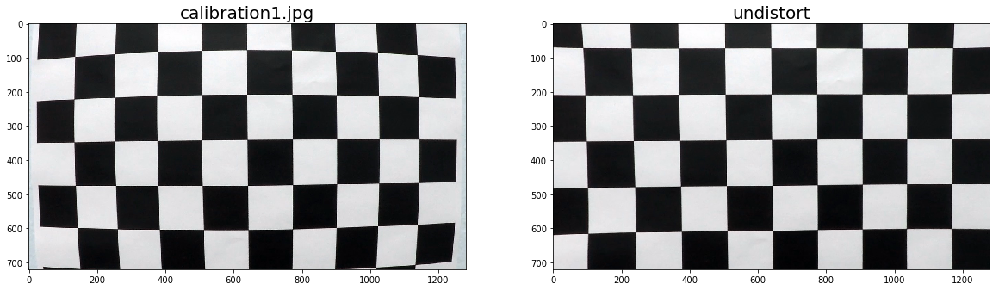

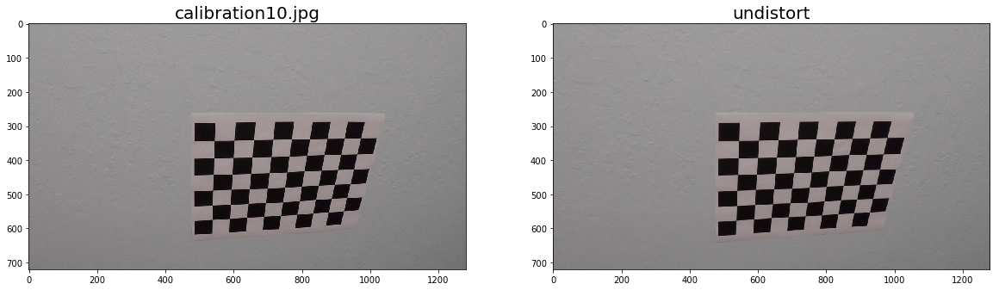

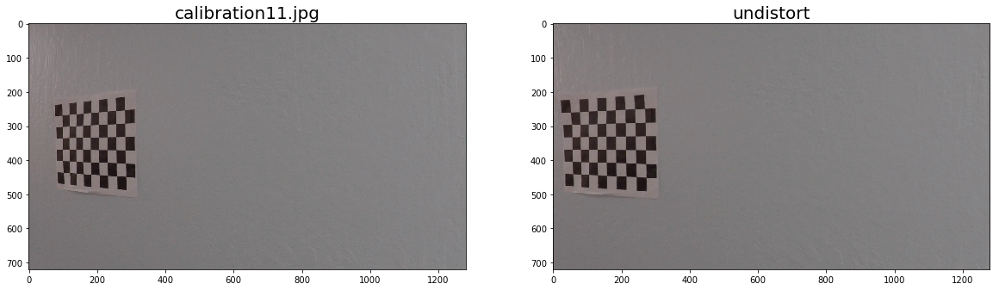

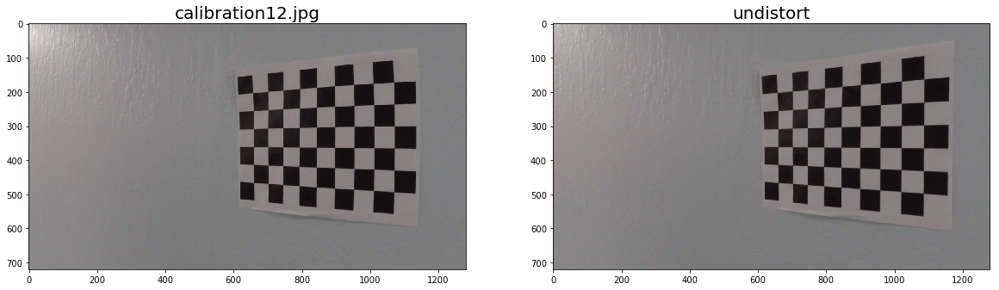

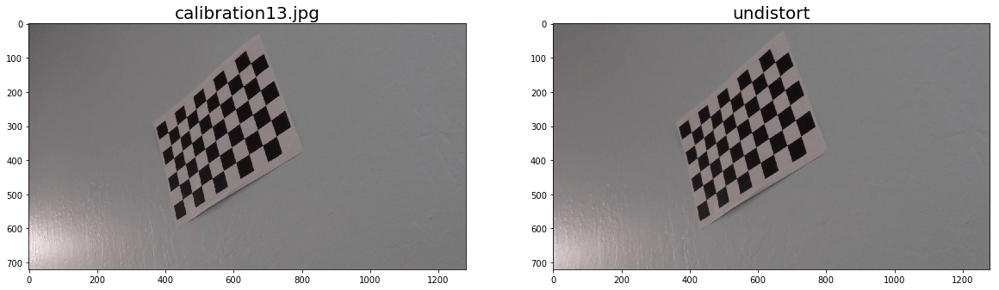

...

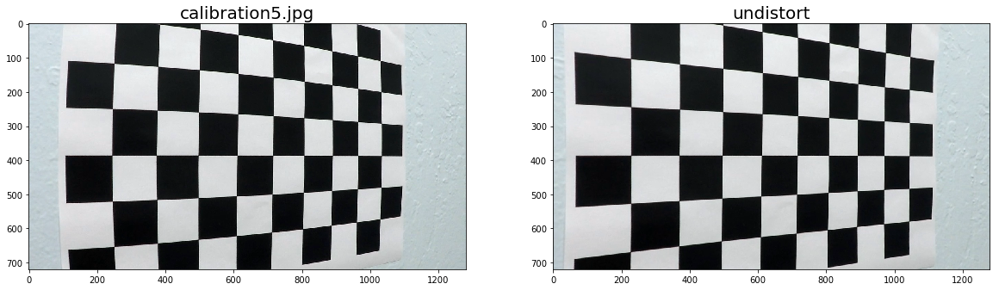

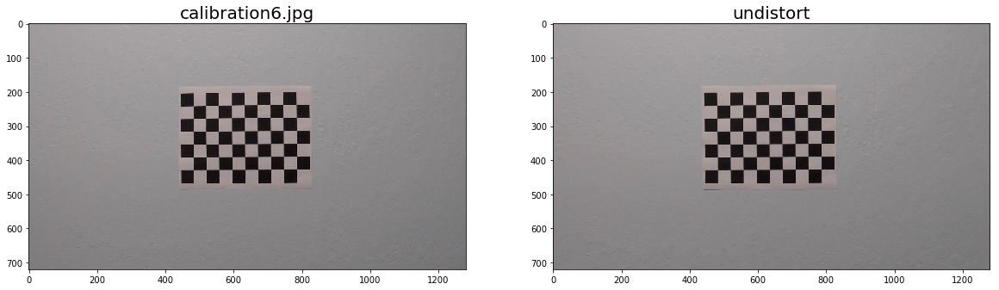

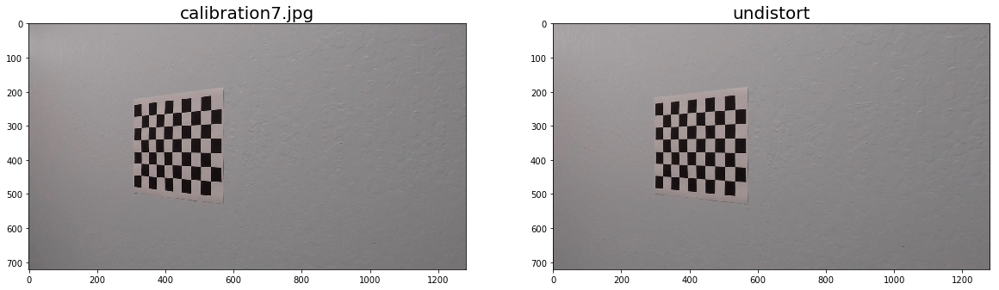

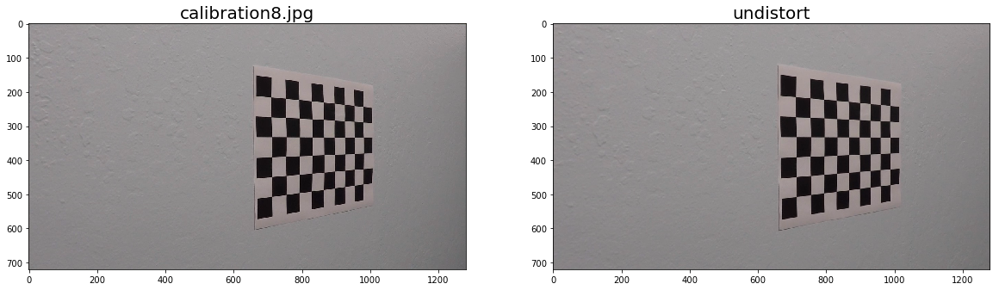

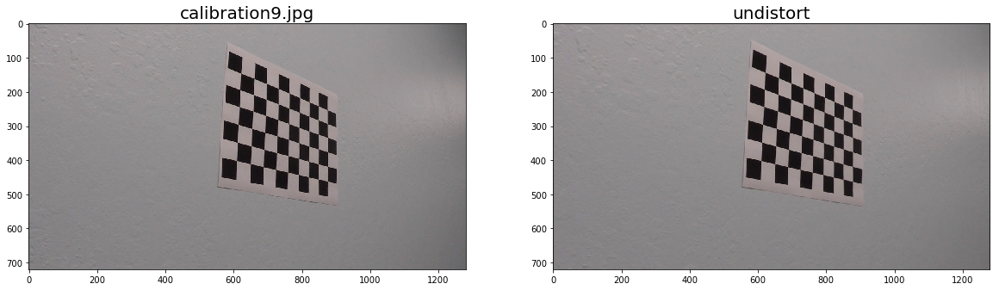

In [4]:
# Read the test image and apply undistortion to it
for image_path in cal_image_files:
    filename = image_path[image_path.rfind('/')+1:]
    test_image = cv2.imread(image_path)
    cal_test_image = cv2.undistort(src=test_image, cameraMatrix=mtx, distCoeffs=dist, dst=None, newCameraMatrix=mtx)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(test_image)
    ax1.set_title(filename, fontsize=20)
    ax2.imshow(cal_test_image)
    ax2.set_title('undistort', fontsize=20)

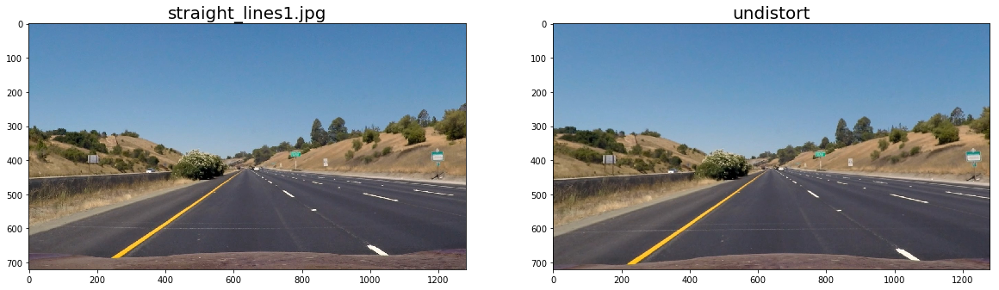

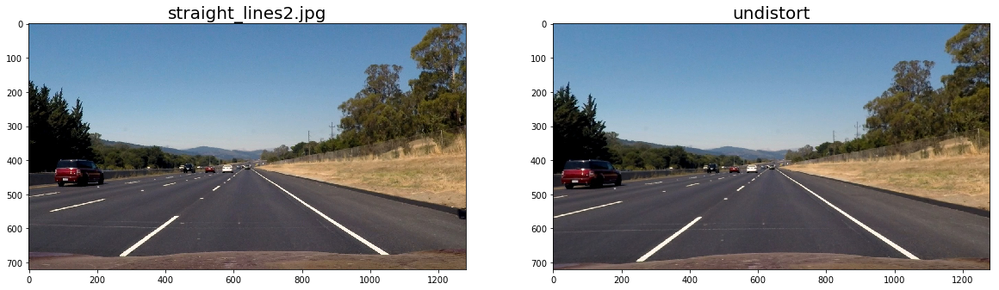

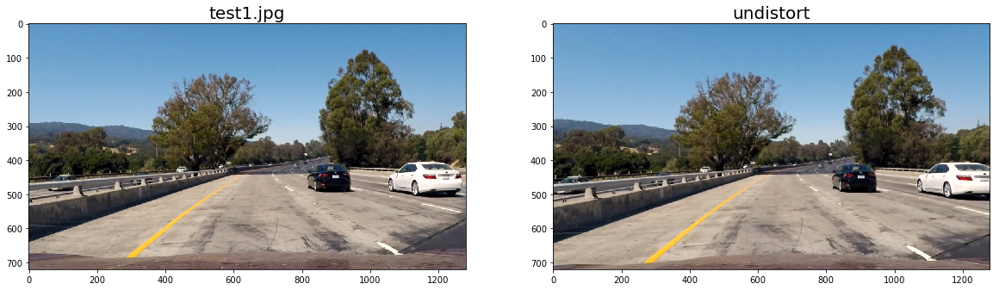

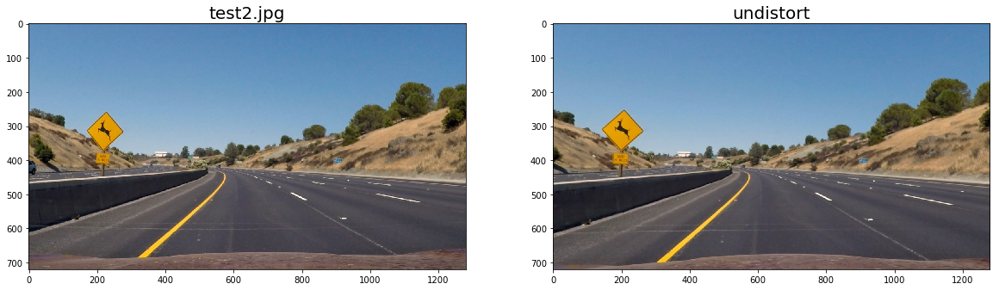

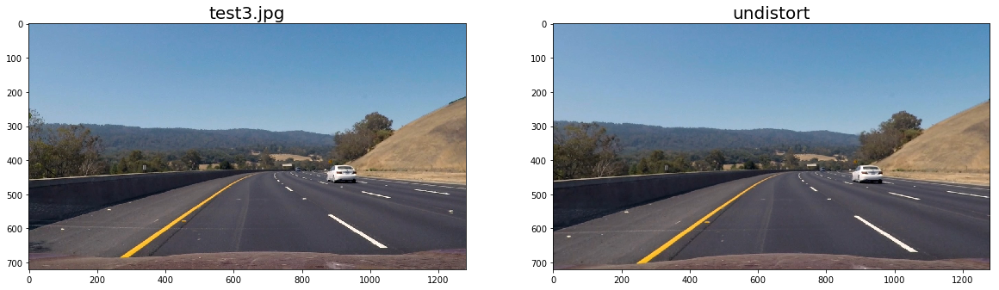

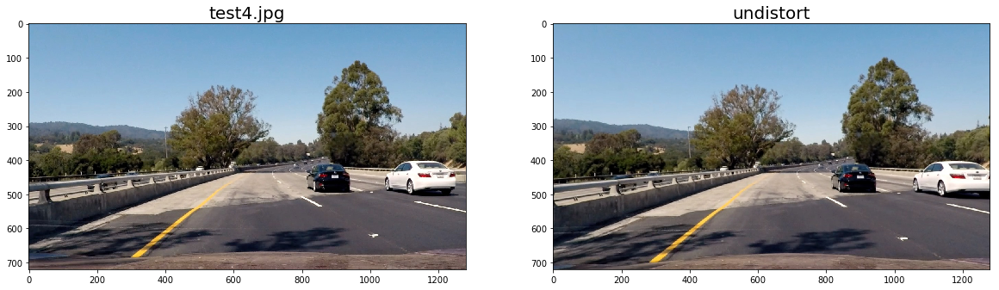

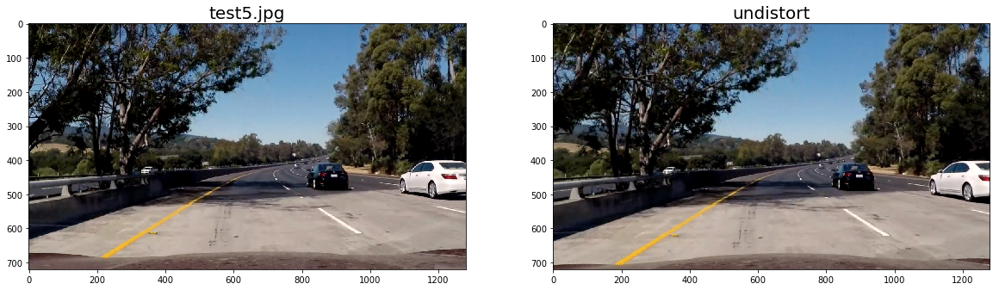

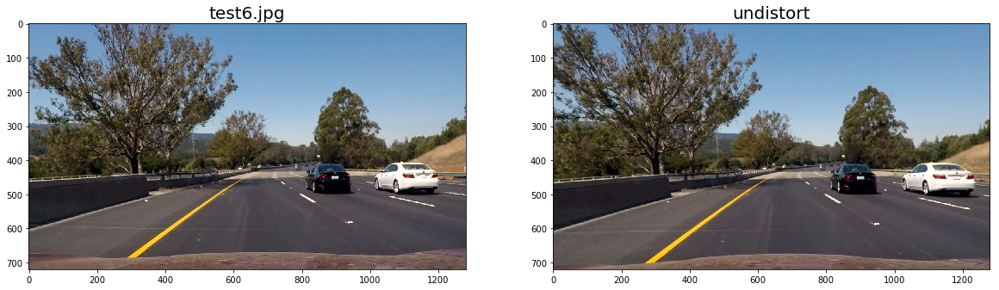

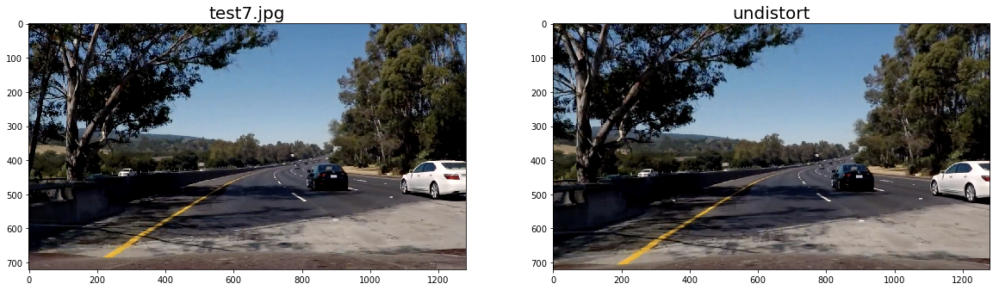

In [5]:
# apply distortion correction on test image
test_image_files = glob.glob('test_images/*.jpg')

for image_path in test_image_files:
    filename = image_path[image_path.rfind('/')+1:]
    road_image = mpimg.imread(image_path)
    cal_road_image = cv2.undistort(src=road_image, cameraMatrix=mtx, distCoeffs=dist, dst=None, newCameraMatrix=mtx)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
    ax1.imshow(road_image)
    ax1.set_title(filename, fontsize=20)
    ax2.imshow(cal_road_image)
    ax2.set_title('undistort', fontsize=20)


## 3. Color gradient threshold

In [6]:
# road_image = mpimg.imread('test_images/test5.jpg')
road_image = mpimg.imread('test_images/test1.jpg')
(image_height, image_width) = (road_image.shape[0], road_image.shape[1])

gray = cv2.cvtColor(road_image, cv2.COLOR_BGR2GRAY)
s_channel = cv2.cvtColor(road_image, cv2.COLOR_RGB2HLS)[:,:,2]
    
v_channel = cv2.cvtColor(road_image, cv2.COLOR_RGB2HSV)[:,:,2]

b_channel = cv2.cvtColor(road_image, cv2.COLOR_RGB2Lab)[:,:,2]   


# f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(20, 10))
# ax1.imshow(gray, cmap='gray')
# ax1.set_title('gray', fontsize=20)
# ax2.imshow(s_channel, cmap='gray')
# ax2.set_title('s_channel', fontsize=20)
# ax3.imshow(v_channel, cmap='gray')
# ax3.set_title('v_channel', fontsize=20)
# ax4.imshow(b_channel, cmap='gray')
# ax4.set_title('b_channel', fontsize=20)

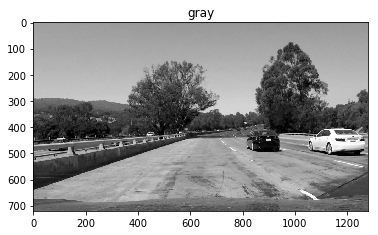

In [7]:
plt.title("gray")
cv2.imwrite('output_images/test1_gray.jpg', gray)
plt.imshow(gray, cmap='gray')

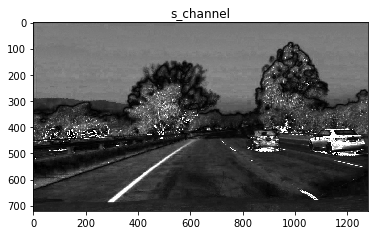

In [8]:
plt.title("s_channel")
cv2.imwrite('output_images/test1_s_ch.jpg', s_channel)
plt.imshow(s_channel, cmap='gray')

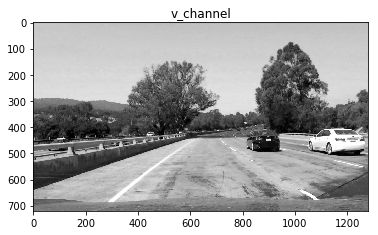

In [9]:
plt.title("v_channel")
cv2.imwrite('output_images/test1_v_ch.jpg', v_channel)
plt.imshow(v_channel, cmap='gray')

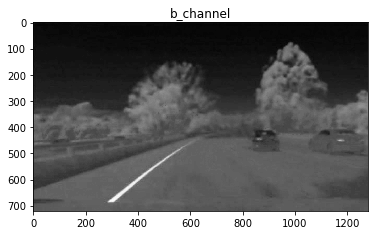

In [10]:
plt.title("b_channel")
cv2.imwrite('output_images/test1_b_ch.jpg', b_channel)
plt.imshow(b_channel, cmap='gray')

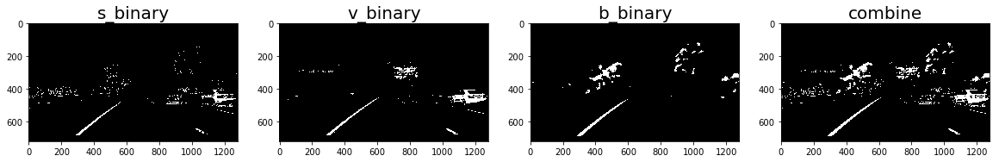

In [11]:
s_binary = np.zeros_like(s_channel)
v_binary = np.zeros_like(v_channel)
b_binary = np.zeros_like(b_channel)

s_thresh = (180, 255)
v_thresh = (225, 255)
b_thresh = (150, 255)

s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
v_binary[(v_channel >= v_thresh[0]) & (v_channel <= v_thresh[1])] = 1
b_binary[(b_channel >= b_thresh[0]) & (b_channel <= b_thresh[1])] = 1

combine = np.zeros_like(s_channel)
combine[(s_binary == 1)|(v_binary == 1)|(b_binary == 1)] = 1

f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(20, 10))
ax1.imshow(s_binary, cmap='gray')
ax1.set_title('s_binary', fontsize=20)
ax2.imshow(v_binary, cmap='gray')
ax2.set_title('v_binary', fontsize=20)
ax3.imshow(b_binary, cmap='gray')
ax3.set_title('b_binary', fontsize=20)
ax4.imshow(combine, cmap='gray')
ax4.set_title('combine', fontsize=20)

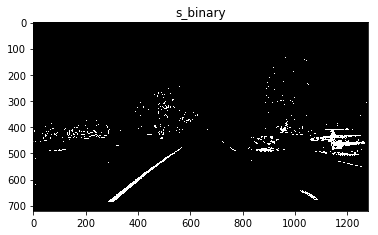

In [12]:
plt.title("s_binary")
cv2.imwrite('output_images/test1_s_binary.png', s_binary*255)
plt.imshow(s_binary, cmap='gray')

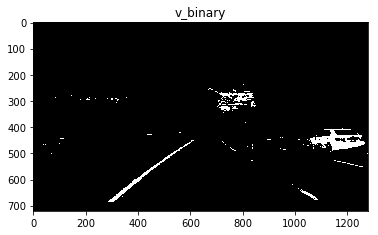

In [13]:
plt.title("v_binary")
cv2.imwrite('output_images/test1_v_binary.jpg', v_binary*255)
plt.imshow(v_binary, cmap='gray')

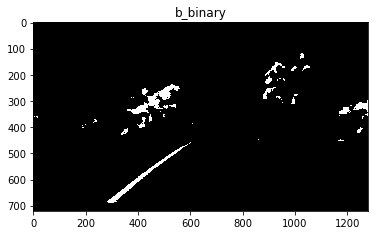

In [14]:
plt.title("b_binary")
cv2.imwrite('output_images/test1_b_binary.jpg', b_binary*255)
plt.imshow(b_binary, cmap='gray')

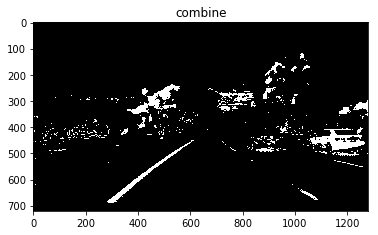

In [15]:
plt.title("combine")
cv2.imwrite('output_images/test1_combine_binary.jpg', combine*255)
plt.imshow(combine, cmap='gray')

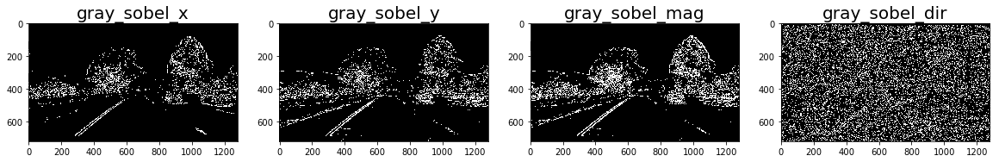

In [16]:
# sobel_x = abs_sobel_thresh(s_channel, orient='x', thresh=(39, 255))
# sobel_y = abs_sobel_thresh(s_channel, orient='y', thresh=(39, 255))
# sobel_mag = mag_thresh(s_channel, thresh=(39, 255))

def draw_sobel_result(image_src, name=''):
    sobel_x = abs_sobel_thresh(image_src, orient='x', sigma=0.66, mode='auto')
    sobel_y = abs_sobel_thresh(image_src, orient='y', sigma=0.66, mode='auto')
    sobel_mag = mag_thresh(image_src, sigma=0.66, mode='auto')
    sobel_dir = dir_threshold(image_src, thresh=(0.65, 1.05))
    
    f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(20, 10))
    
    ax1.imshow(sobel_x, cmap='gray')
    title = name + '_sobel_x'
    ax1.set_title(title, fontsize=20)
    
    ax2.imshow(sobel_y, cmap='gray')
    title = name + '_sobel_y'
    ax2.set_title(title, fontsize=20)
    
    ax3.imshow(sobel_mag, cmap='gray')
    title = name + '_sobel_mag'
    ax3.set_title(title, fontsize=20)

    ax4.imshow(sobel_dir, cmap='gray')
    title = name + '_sobel_dir'
    ax4.set_title(title, fontsize=20)
    
    sobel_combine = np.zeros_like(sobel_x)
    sobel_combine[(sobel_x==1)&(sobel_y==1)|(sobel_mag==1)&(sobel_dir==1)] = 1
    
    return sobel_combine


# src_list = [('s_channel', s_channel), ('v_channel', v_channel), ('b_channel', b_channel)]
sobel_result = draw_sobel_result(s_channel, name='gray')
# plt.imshow(sobel_result)


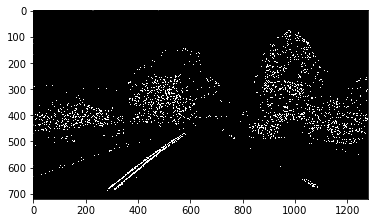

In [17]:
plt.imshow(sobel_result, cmap='gray')

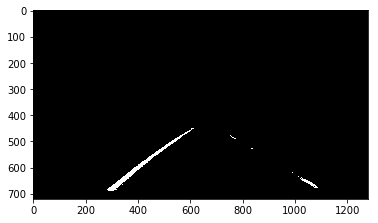

In [18]:
# combine them all
# combine = np.zeros_like(s_channel)
# combine[(combine==1) | (s_binary == 1) | (sobel_x == 1) | (sobel_y == 1) | (sobel_mag == 1)] = 1
# combine[(combine==1)|(sobel_result==1)] = 1

left_x = 40
right_x = image_width - 40
top_y = 0
bottom_y = image_height
mid_left_x = image_width / 2 - 1
mid_left_y = image_height / 2 + 60
mid_right_x = mid_left_x + 1
mid_right_y = mid_left_y
vertices = np.array([[(left_x,bottom_y),
                      (mid_left_x, mid_left_y), 
                      (mid_right_x, mid_right_y), 
                      (right_x, bottom_y)]], 
                    dtype=np.int32)
region_masked = region_of_interest(combine, vertices)
cv2.imwrite('output_images/ROI_binary.jpg', region_masked*255)
plt.imshow(region_masked, cmap='gray')

## 4. Perspective transform

src [[  585.           460.        ]
 [  203.33332825   720.        ]
 [ 1126.66662598   720.        ]
 [  695.           460.        ]]
dst [[ 320.    0.]
 [ 320.  720.]
 [ 960.  720.]
 [ 960.    0.]]


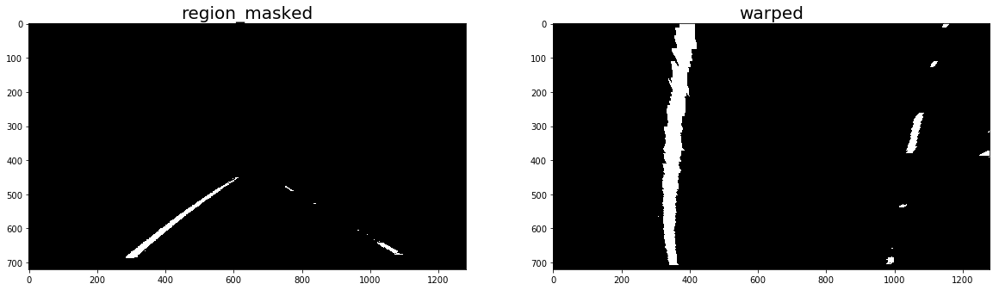

In [19]:
src = np.float32(
    [[(image_width / 2) - 55, image_height / 2 + 100],
    [((image_width / 6) - 10), image_height],
    [(image_width * 5 / 6) + 60, image_height],
    [(image_width / 2 + 55), image_height / 2 + 100]])
dst = np.float32(
    [[(image_width / 4), 0],
    [(image_width / 4), image_height],
    [(image_width * 3 / 4), image_height],
    [(image_width * 3 / 4), 0]])
print('src', src)
print('dst', dst)
# src = np.float32([[490, 482],[810, 482],
#                   [40, 720], [1250, 720]])

# dst = np.float32([[0, 0], [1280, 0], 
#                   [40, 720], [1250, 720]])

# src = np.float32([[150+430,460],[1150-440,460],[1150,720],[150,720]])
# offset = 200
# dst = np.float32([[offset, 0], 
#                       [image_width-offset, 0], 
#                       [image_width-offset, image_height], 
#                       [offset, image_height]])

# utils.perspective_transform(image, src, dst)
warped, transform_matrix = warper(combine, src, dst)

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
ax1.imshow(region_masked, cmap='gray')
ax1.set_title('region_masked', fontsize=20)
ax2.imshow(warped, cmap='gray')
ax2.set_title('warped', fontsize=20)

## 5. Detect lane lines

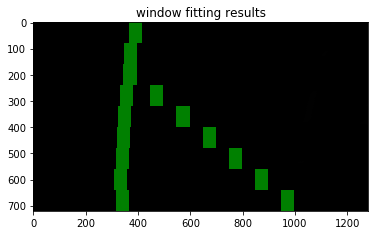

In [20]:
window_width = 50
window_height = 80
margin = 100

# utils.find_window_centroids()
window_centroids = find_window_centroids_conv(warped, window_width, window_height, margin)

if len(window_centroids) > 0:
    
    l_points = np.zeros_like(warped)
    r_points = np.zeros_like(warped)
    
    for level in range(0, len(window_centroids)):
        # utils.window_mask()
        l_mask = window_mask(window_width, window_height, warped, window_centroids[level][0], level)
        r_mask = window_mask(window_width, window_height, warped, window_centroids[level][1], level)
        
        l_points[ (l_points == 255) | (l_mask == 1) ] = 255
        r_points[ (r_points == 255) | (r_mask == 1) ] = 255
    
    template = np.array(r_points+l_points, np.uint8)
    zero_channel = np.zeros_like(template)

    # draw window in green color
    template = np.array(cv2.merge((zero_channel, template, zero_channel)), np.uint8)
    
    warpage = np.array(cv2.merge((warped, warped, warped)), np.uint8)
    
    output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0)


else:
    output = np.array(cv2.merge((warped, warped, warped)), np.uint8)

    
plt.imshow(output)
plt.title('window fitting results')
plt.show()

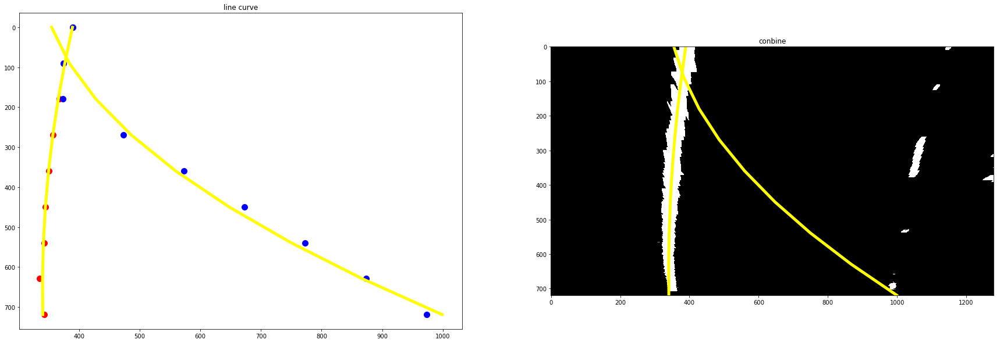

In [21]:
out_image = np.dstack((warped, warped, warped))*255

(left_fit_coeff, left_fitx, right_fit_coeff, right_fitx) = fit_lane_line(window_centroids=window_centroids, image_size=(image_width, image_height))



# Get Centroid of Left Lane
leftx = np.array([left for (left, right) in window_centroids])
# Get Centroid of Right Lane
rightx = np.array([right for (left, right) in window_centroids])
leftx = leftx[::-1]
rightx = rightx[::-1]
ploty = np.linspace(0, warped.shape[0]-1, leftx.shape[0])

# # Fit a second order polynomial to pixel positions in each lane line
# left_fit = np.polyfit(ploty, leftx, 2)
# left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
# right_fit = np.polyfit(ploty, rightx, 2)
# right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

# Plot up 
mark_size = 10
line_width = 5

f, (ax1, ax2) = plt.subplots(1, 2, figsize=(30,10))
ax1.set_title('line curve')
# Draw Point
ax1.plot(leftx, ploty, 'o', color='red', markersize=mark_size)
ax1.plot(rightx, ploty, 'o', color='blue', markersize=mark_size)
# Draw curve line
ax1.plot(left_fitx, ploty, color='yellow', linewidth=line_width)
ax1.plot(right_fitx, ploty, color='yellow', linewidth=line_width)
ax1.invert_yaxis() # to visualize as we do the images

ax2.set_title('conbine')
ax2.imshow(out_image)
ax2.plot(left_fitx, ploty, color='yellow', linewidth=line_width)
ax2.plot(right_fitx, ploty, color='yellow', linewidth=line_width)

In [22]:
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None

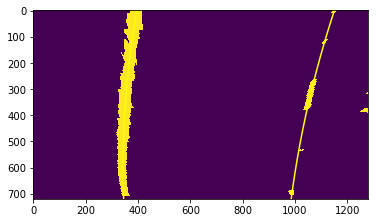

In [23]:
(left_fit_coeff, left_fitx, right_fit_coeff, right_fitx, ploty) = find_window_centroids_window_search(warped, left_line=Line(), right_line=Line())
# print('left_fit_coeff', left_fit_coeff)
# print('left_fitx', left_fitx.shape)

left_line_pt = np.reshape(np.column_stack((left_fitx, ploty)), (1, -1, 2))
right_line_pt = np.reshape(np.column_stack((right_fitx, ploty)), (1, -1, 2))
test_v2 = np.dstack((warped, warped, warped))*255

cv2.polylines(test_v2, np.int32(left_line_pt), False, (0, 255, 255), thickness=5)
cv2.polylines(test_v2, np.int32(right_line_pt), False, (0, 255, 255), thickness=5)
cv2.imwrite('output_images/bird_view_lane_line.jpg', test_v2)

plt.imshow(warped)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')

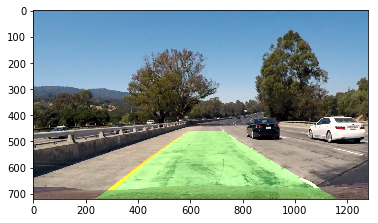

In [24]:
(invM, result) = draw_lane_field(image=road_image, warped=warped, four_point_src=src, four_point_dst=dst, x_fits=(left_fitx, right_fitx))

cv2.imwrite('output_images/draw_line.jpg', cv2.cvtColor(result, cv2.COLOR_RGB2BGR))
plt.imshow(result)



## Determine the lane curvature

In [25]:
y_eval = np.max(ploty)
left_curverad = ((1 + (2*left_fit_coeff[0]*y_eval + left_fit_coeff[1])**2)**1.5) / np.absolute(2*left_fit_coeff[0])
right_curverad = ((1 + (2*right_fit_coeff[0]*y_eval + right_fit_coeff[1])**2)**1.5) / np.absolute(2*right_fit_coeff[0])
print("Left_curverad\t: {}\nRight_curverad\t: {}".format(left_curverad, right_curverad))

Left_curverad	: 3301.5712111959465
Right_curverad	: 3762.540756296661


In [26]:
# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

# Fit new polynomials to x,y in world space
left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
# Calculate the new radii of curvature
left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
# Now our radius of curvature is in meters
print("left curverad\t: {} m \nright_curverad\t: {} m".format(left_curverad, right_curverad))

left curverad	: 1081.9918285778692 m 
right_curverad	: 1205.1492256958004 m


## Put them all togther 

In [27]:
from collections import deque
left_Line = Line()
right_Line = Line()
max_frame = 20
avg_left_xfitted = deque(maxlen=max_frame)
avg_left_fit = deque(maxlen=max_frame)
avg_right_xfitted = deque(maxlen=max_frame)
avg_right_fit = deque(maxlen=max_frame)

In [28]:
def find_window_centroids_check(binary_img, left_Line, right_Line):
    half = np.int(binary_img.shape[0]/2)

    # calculate histogram (vector) of the bottom half of s_binary
    # hostogram is a vector 
    histogram = np.sum(binary_img[half:, :], axis=0)
    out_image = np.dstack((binary_img, binary_img, binary_img))*255

    midpoint = int(histogram.shape[0]/2)

#     leftx_base = np.argmax(histogram[:midpoint])
#     rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # number of sliding windows
    nwindows = 9

    window_height = np.int(binary_img.shape[0]/nwindows)

    nonzero = binary_img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    if left_Line.detected == True:
        letx_current = left_Line.bestx
    else:
        leftx_current = np.argmax(histogram[:midpoint])
    
    if right_Line.detected == True:
        rightx_current = right_Line.bestx
    else:
        rightx_current = np.argmax(histogram[midpoint:]) + midpoint

    # set the width of windows +/- margin
    margin = 100

    # Set minimum number of pixels found to recenter window
    minpix = 50

    left_lane_inds = []
    right_lane_inds = []

    for window in range(nwindows):
        # 由 image 下到上移動 sliding window
        win_y_low = binary_img.shape[0] - (window+1)*window_height
        win_y_high = binary_img.shape[0] - window*window_height
        
        # 左半邊的 sliding window
        win_xleft_low = int(leftx_current - margin)
        win_xleft_high = int(leftx_current + margin)

        # 右半邊的 sliding window
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        # 畫左半邊的 sliding window
        cv2.rectangle(out_image, (win_xleft_low, win_y_low), (win_xleft_high, win_y_high), (0, 255, 0), 3)
        # 畫右半邊的 sliding window
        cv2.rectangle(out_image, (win_xright_low, win_y_low), (win_xright_high, win_y_high), (0, 255, 0), 3)
        
        

        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
                          (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]

        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) &
                          (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        left_lane_inds.append(good_left_inds)

        right_lane_inds.append(good_right_inds)
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))

        if len(good_right_inds) > minpix:
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))


    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds]
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]


    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    ploty = np.linspace(0, binary_img.shape[0]-1, binary_img.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        
    y_eval = np.max(ploty)
    left_curverad = ((1 + (2*left_fit_coeff[0]*y_eval + left_fit[1])**2)**1.5) / np.absolute(2*left_fit[0])
    right_curverad = ((1 + (2*right_fit_coeff[0]*y_eval + right_fit[1])**2)**1.5) / np.absolute(2*right_fit[0])    
#     print("Left_curverad\t: {}\nRight_curverad\t: {}".format(left_curverad, right_curverad))        
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, left_fitx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, right_fitx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    
#     print('left curverad\t: {}\nright curverad\t: {}'.format(left_curverad, right_curverad))
    
    #
    # Check Left and Right Lane Line are in parallel or not
    #
    don = min(left_curverad, right_curverad)
    mol = max(left_curverad, right_curverad)
    ratio = mol / don
#     print("ratio:", mol/don)
    
    if ratio >= 3.5:
#         print("abo-left_Line.recent_xfitted:", left_Line.recent_xfitted)
#         print("abo-right_Line.recent_xfitted:", right_Line.recent_xfitted)        
        # for Left Lane Line
        l_don = min(left_curverad, left_Line.radius_of_curvature)
        l_mol = max(left_curverad, left_Line.radius_of_curvature)
        l_ratio = l_mol / l_don
        if l_ratio > 3.5:
            left_fit = left_Line.current_fit
            left_fitx = left_Line.recent_xfitted
        
        # for Right Lane Line
        r_don = min(right_curverad, right_Line.radius_of_curvature)
        r_mol = max(right_curverad, right_Line.radius_of_curvature)
        r_ratio = r_mol / r_don
        if r_ratio > 3.5:
            right_fit = right_Line.current_fit
            right_fitx = right_Line.recent_xfitted
    else:
        # Left
        left_Line.radius_of_curvature = left_curverad
        
        avg_left_fit.append(left_fit)
        avg_left_xfitted.append(left_fitx)
        left_Line.current_fit = np.average(avg_left_fit, axis=0)
        left_Line.recent_xfitted = np.average(avg_left_xfitted, axis=0)
        
        
        right_Line.radius_of_curvature = right_curverad
        
        avg_right_fit.append(right_fit)
        avg_right_xfitted.append(right_fitx)
        right_Line.current_fit = np.average(avg_right_fit, axis=0)
        right_Line.recent_xfitted = np.average(avg_right_xfitted, axis=0)
        
    
#         print("left_Line.recent_xfitted:", left_Line.recent_xfitted)
#         print("right_Line.recent_xfitted:", right_Line.recent_xfitted)        



#     return ploty 
#     return (left_fit, left_fitx, right_fit, right_fitx, ploty)
    return (left_Line.current_fit, left_Line.recent_xfitted, right_Line.current_fit, right_Line.recent_xfitted, ploty)

In [29]:
def process_image(image, display_result = False):
    (image_height, image_width) = (image.shape[0], image.shape[1])
    
    ###
    # 1. Color threshold
    # convert image to the color spaces what we need
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    s_channel = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)[:,:,2]
    v_channel = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)[:,:,2]
    b_channel = cv2.cvtColor(image, cv2.COLOR_RGB2Lab)[:,:,2]
    
    # create corresponding binary matrix
    s_binary = np.zeros_like(s_channel)
    v_binary = np.zeros_like(v_channel)
    b_binary = np.zeros_like(b_channel)
    
    # setup the corresponding threshold for each color space
    s_thresh = (180, 255)
    v_thresh = (225, 255)
    b_thresh = (150, 255)
    
    # threshold the image
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    v_binary[(v_channel >= v_thresh[0]) & (v_channel <= v_thresh[1])] = 1
    b_binary[(b_channel >= b_thresh[0]) & (b_channel <= b_thresh[1])] = 1
    
    # combine each binary image
    combine = np.zeros_like(s_channel)
    combine[(s_binary == 1)|(v_binary == 1)|(b_binary == 1)] = 1

    # apple sobel operation for edge detection
    sobel_x = abs_sobel_thresh(s_channel, orient='x', sigma=0.66, mode='auto')
    sobel_y = abs_sobel_thresh(s_channel, orient='y', sigma=0.66, mode='auto')
    sobel_mag = mag_thresh(s_channel, sigma=0.66, mode='auto')
    sobel_dir = dir_threshold(s_channel, thresh=(0.65, 1.05))
    sobel_combine = np.zeros_like(sobel_x)
    sobel_combine[(sobel_x==1)&(sobel_y==1)|(sobel_mag==1)&(sobel_dir==1)] = 1
    # combine binary and sobel image
#     combine[(combine==1)|(sobel_result==1)] = 1
    # setup regino of interest
    left_x = 40
    right_x = image_width - 40
    top_y = 0
    bottom_y = image_height
    mid_left_x = image_width / 2 - 1
    mid_left_y = image_height / 2 + 50
    mid_right_x = mid_left_x + 1
    mid_right_y = mid_left_y
    vertices = np.array([[(left_x,bottom_y),
                          (mid_left_x, mid_left_y), 
                          (mid_right_x, mid_right_y), 
                          (right_x, bottom_y)]], 
                        dtype=np.int32)
    region_masked = region_of_interest(combine, vertices)
    
#     if display_result == True:
#         f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(30,10))
#         ax1.set_title('region_masked', fontsize=20)
#         ax1.imshow(region_masked)
#         ax2.set_title('s_binary', fontsize=20)
#         ax2.imshow(s_binary)
#         ax3.set_title('v_binary', fontsize=20)
#         ax3.imshow(v_binary)
#         ax4.set_title('b_binary', fontsize=20)
#         ax4.imshow(b_binary)
    
    
    ###
    # 2. Perspective transform
    # setup four point of source and destination for perspective transform
#     src = np.float32([[490, 482],[810, 482],
#                   [40, 720], [1250, 720]])

#     dst = np.float32([[0, 0], [1280, 0], 
#                       [40, 720], [1250, 720]])
    src = np.float32([[150+430,460],[1150-440,460],[1150,720],[150,720]])
    offset = 200
    dst = np.float32([[offset, 0], 
                      [image_width-offset, 0], 
                      [image_width-offset, image_height], 
                      [offset, image_height]])

    # utils.perspective_transform(image, src, dst)
    warped, transform_matrix = warper(region_masked, src, dst)
     

    
    
    ###
    # 3. Detect lane lines and Determine the lane curvature
    (left_fit_coeff, left_fitx, right_fit_coeff, right_fitx, ploty) = find_window_centroids_check(warped, left_Line, right_Line)
    
    # draw land region
    (invM, draw_result) = draw_lane_field(image=image, 
                                     warped=warped, 
                                     four_point_src=src, 
                                     four_point_dst=dst, 
                                     x_fits=(left_fitx, right_fitx))
    
    if draw_result is None:
        print("no draw result")
    
    font = cv2.FONT_HERSHEY_SIMPLEX
    text = "Radius of Left Curvature: {} m".format(int(left_Line.radius_of_curvature))
    cv2.putText(result,text,(400,100), font, 1,(255,255,255),2)
    text = "Radius of Left Curvature: {} m".format(int(right_Line.radius_of_curvature))
    cv2.putText(result,text,(400,130), font, 1,(255,255,255),2)

#     print("left_Line.recent_xfitted", left_Line.recent_xfitted.shape)
    
    
    if display_result == True:
        bird_view = np.dstack((warped, warped, warped))*255
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(30,10))
        ax1.set_title('conbine', fontsize=20)
        ax1.imshow(bird_view)
        ax1.plot(left_fitx, ploty, color='yellow', linewidth=line_width)
        ax1.plot(right_fitx, ploty, color='yellow', linewidth=line_width)

        ax2.set_title('result', fontsize=20)
        ax2.imshow(draw_result)
    
    return draw_result


 1 fail/project_video.mp4 - 00.00.39.080.jpg

 2 fail/project_video.mp4 - 00.00.39.760.jpg

 3 fail/project_video.mp4 - 00.00.40.920.jpg

 4 fail/project_video.mp4 - 00.00.41.400.jpg

 5 fail/project_video.mp4 - 00.00.41.520.jpg

 6 fail/project_video.mp4 - 00.00.41.600.jpg

 7 fail/project_video.mp4 - 00.00.41.680.jpg

 8 fail/project_video.mp4 - 00.00.41.760.jpg

 9 fail/project_video.mp4 - 00.00.41.840.jpg

 10 fail/project_video.mp4 - 00.00.41.920.jpg

 11 fail/project_video.mp4 - 00.00.42.000.jpg

 12 fail/project_video.mp4 - 00.00.42.120.jpg

 13 fail/project_video.mp4 - 00.00.42.200.jpg

 14 fail/project_video.mp4 - 00.00.42.240.jpg

 15 fail/project_video.mp4 - 00.00.42.360.jpg

 16 fail/project_video.mp4 - 00.00.42.440.jpg

 17 fail/project_video.mp4 - 00.00.42.520.jpg

 18 fail/project_video.mp4 - 00.00.42.600.jpg

 19 fail/project_video.mp4 - 00.00.42.680.jpg


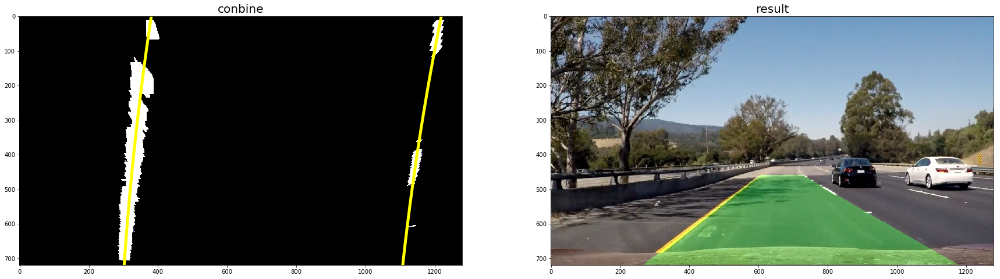

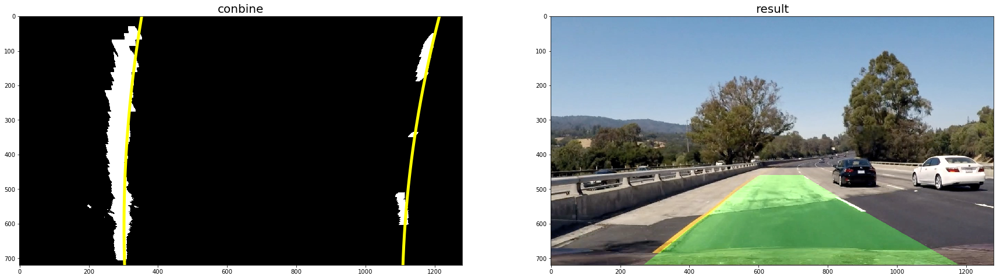

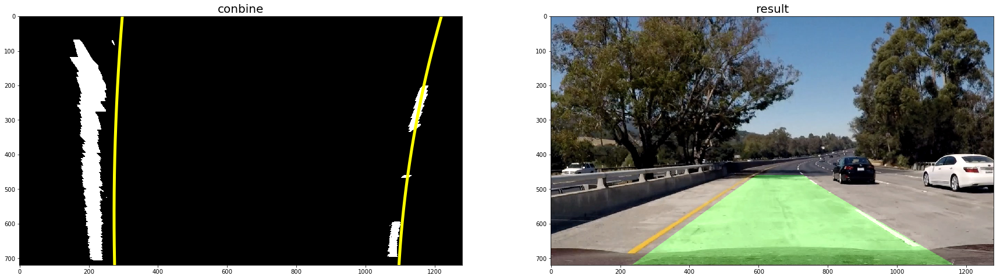

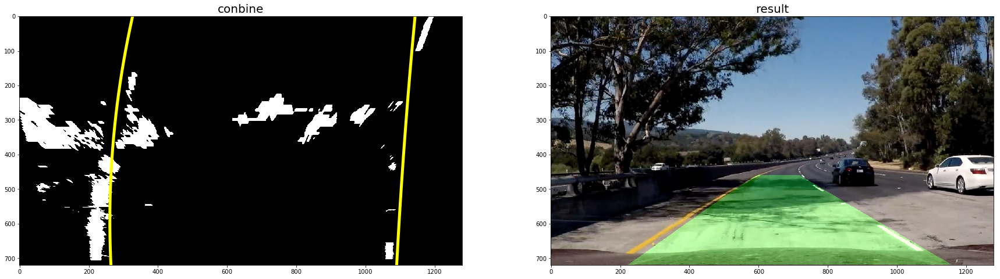

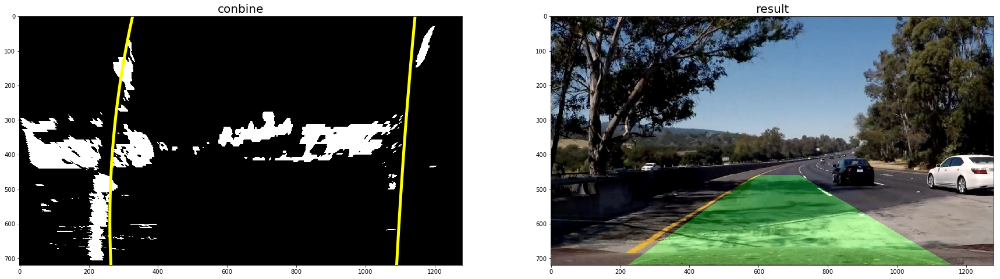

...

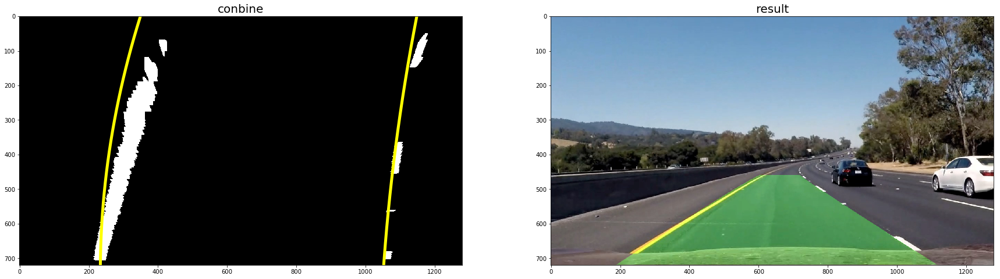

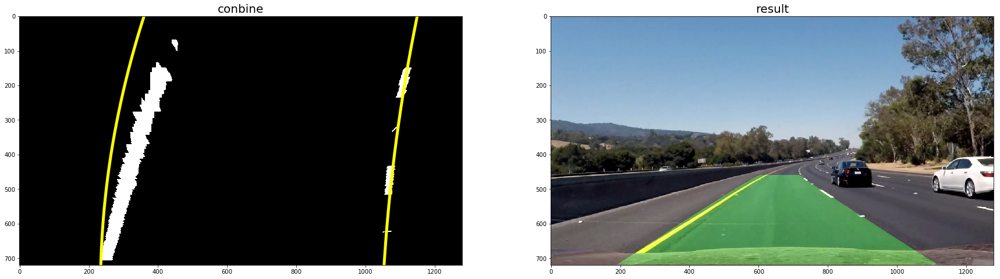

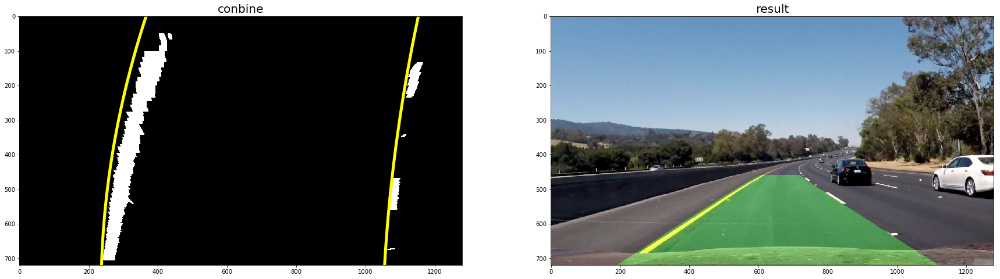

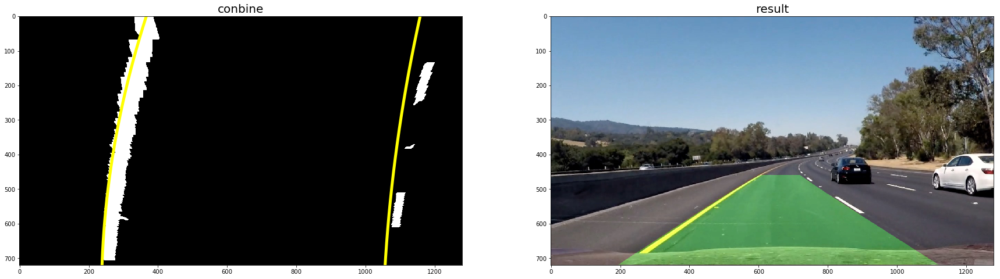

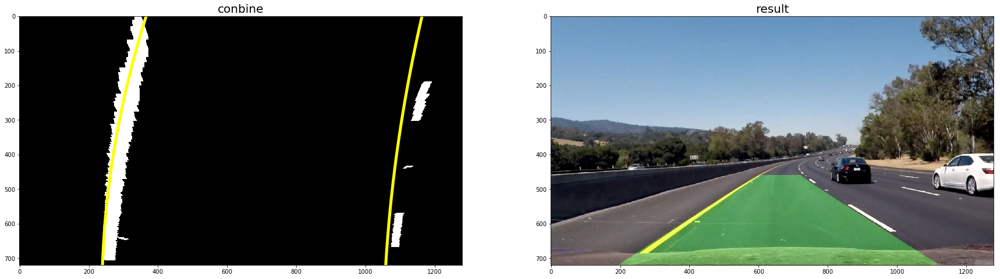

In [30]:
test_image_files = glob.glob('fail/*.jpg')
for index, image_path in enumerate(test_image_files):
    image = mpimg.imread(image_path)
    print('\n', index+1, image_path,)
    result = process_image(image, display_result=True)

In [32]:
from moviepy.editor import VideoFileClip
bRecord = False
# if bRecord == True:
#     project_video_output = 'project_video_output.mp4'
#     clip1 = VideoFileClip("project_video.mp4")
#     proj_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
#     %time proj_clip.write_videofile(project_video_output, audio=False)

#     project_video_output = 'challenge_video_output.mp4'
#     clip1 = VideoFileClip("challenge_video.mp4")
#     proj_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
#     %time proj_clip.write_videofile(project_video_output, audio=False)
    
#     project_video_output = 'harder_challenge_video_output.mp4'
#     clip1 = VideoFileClip("harder_challenge_video.mp4")
#     proj_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
#     %time proj_clip.write_videofile(project_video_output, audio=False)